## **Yolo-World Object Detection**

### **Overview**

In this notebook, we explore Yolo-World, a zero-shot object detector with the following features:
- **Zero-shot object detection**
- **Open-vocabulary support**
- **Real-time processing**
- **Extremely fast (~20x) compared to other zero-shot detectors like GroundingDINO**
- **Pre-encodes user prompts into an offline vocabulary, eliminating real-time text encoding during inference**


## References

- [Yolo-World - Tencent AI Lab](https://example.com)
- [Yolo-World Paper - Feb/2024](https://arxiv.org/abs/XXXX.XXXX)
- [Yolo-World GitHub](https://github.com/username/yolo-world)
- [Yolo-World - Roboflow Blog](https://blog.roboflow.com/yolo-world/)
- [Yolo-World - Ultralytics Docs](https://docs.ultralytics.com/yolo-world/)
- [Hugging Face Space](https://huggingface.co/spaces/yolo-world)

# Installs/Imports

In [1]:
from IPython.display import clear_output

!pip install ultralytics -qq
!pip install dill -qq

clear_output()

# Imported Libraries:

In [2]:
from ultralytics import YOLOWorld

import time, os, re, subprocess

from IPython.display import Video

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import cv2

print(f'cv2 version: {cv2.__version__}')

cv2 version: 4.9.0


# Configuration (CFG)

In [3]:
class CFG:
    ### model
    MODEL_NAME = 'yolov8l-world.pt'

    ### detections
    CLASSES_TO_DETECT = ['dog', 'chicken', 'ball'] 
    CONFIDENCE = 0.15

    ### input videos
    VID_001 = '/kaggle/input/dog-and-chicken/dog chicken.mp4'
    FILENAME = VID_001.split('/')[-1]

    ### save path
    OUTPUT_DIR = './'

# Video Properties

In [4]:
def get_video_properties(video_path):
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        raise ValueError("Could not open video file")
    properties = {
        "fps": int(cap.get(cv2.CAP_PROP_FPS)),
        "frame_count": int(cap.get(cv2.CAP_PROP_FRAME_COUNT)),
        "duration_seconds": int(cap.get(cv2.CAP_PROP_FRAME_COUNT) / cap.get(cv2.CAP_PROP_FPS)),
        "width": int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)),
        "height": int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)),
        "codec": int(cap.get(cv2.CAP_PROP_FOURCC)),
    }
    cap.release()
    return properties

video_properties = get_video_properties(CFG.VID_001)
video_properties

{'fps': 30,
 'frame_count': 991,
 'duration_seconds': 33,
 'width': 576,
 'height': 720,
 'codec': 875967080}

# Model Setup

In [5]:
%%time
model = YOLOWorld(CFG.MODEL_NAME)
model.set_classes(CFG.CLASSES_TO_DETECT)

CPU times: user 5.15 s, sys: 1.69 s, total: 6.84 s
Wall time: 6.86 s


# Inference

In [6]:
start_time = time.time()
results = model.predict(
    source=CFG.VID_001,
    conf=CFG.CONFIDENCE,
    half=True,
    device=[0],  # single GPU
    batch=16,  # Adjust batch size if necessary
    stream_buffer=False,
    imgsz=(video_properties['height'], video_properties['width']),
    save=True,
    save_txt=True,
    save_conf=True,
    show_labels=True,
    show_conf=True,
    show_boxes=True,
)
end_time = time.time()
elapsed_time = end_time - start_time

print(f"Inference time: {round(elapsed_time, 2)} seconds")
print(f"Duration: {video_properties['duration_seconds']} seconds")
print(f"Number of frames in video: {video_properties['frame_count']}")
print(f"Frames per second (fps): {video_properties['fps']}")
print(f"\nInference speed: {round(video_properties['frame_count']/elapsed_time, 2)} frames/second")


WARNING ⚠️ imgsz=[720, 576] must be multiple of max stride 32, updating to [736, 576]

WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/991) /kaggle/input/dog-and-chicken/dog chicken.mp4: 736x576 1 ball, 20.6ms
video 1/1 (frame 2/991) /kaggle/input/dog-and-chicken/dog chicken.mp4: 736x576 1 dog, 1 ball, 20.6ms
video 1/1 (frame 3/991) /kaggle/input/dog-and-chicken/dog chicken.mp4: 736x576 1 dog, 1 ball, 20.6ms
video 1/1 (frame 4/991) /kaggle/input/dog-and-chicken/dog chicken.mp4: 736

# Exporting the Model

In [7]:
model.save(CFG.OUTPUT_DIR + CFG.MODEL_NAME.replace('.pt', '_export.pt'))

# Loading the Model

In [8]:
# loaded_model = YOLOWorld('/kaggle/working/yolov8l-world_export.pt')

# Analyzing Predictions
Extract Predictions from Inference:

In [9]:
def get_predictions_df_for_videos(run='', model=model, video_info=video_properties, save_df=True):
    df = pd.DataFrame()
    root = f'./runs/detect/predict{run}/labels/'
    pieces = sorted([i for i in os.listdir(root)])
    
    for i, frame_txt in enumerate([i for i in pieces]):
        df = pd.read_csv(root + frame_txt, sep=" ", header=None)
        df.columns = ["class", "x_center", "y_center", "width", "height", "confidence"]
        frame_number = re.findall(r'\d+', frame_txt)[-1]
        df['frame'] = [int(frame_number) for i in range(len(df))]
        df_concat = pd.concat([df_concat, df], axis=0).reset_index(drop=True) if i > 0 else df
        
    df_concat['x_min'] = (df_concat['x_center'] * video_info['width']) - ((df_concat['width'] * video_info['width'])/2)
    df_concat['x_max'] = (df_concat['x_center'] * video_info['width']) + ((df_concat['width'] * video_info['width'])/2)
    df_concat['y_min'] = (df_concat['y_center'] * video_info['height']) - ((df_concat['height'] * video_info['height'])/2)
    df_concat['y_max'] = (df_concat['y_center'] * video_info['height']) + ((df_concat['height'] * video_info['height']/2))
    
    df_concat['width_px'] = (df_concat['width'] * video_info['width']).round(0).astype(int)
    df_concat['height_px'] = (df_concat['height'] * video_info['height']).round(0).astype(int)
    
    df_concat = df_concat.sort_values(by='frame', ascending=True).reset_index(drop=True)
    df_concat['class_name'] = df_concat['class'].map(model.names)
    other_cols = [col for col in df_concat.columns.to_list() if col not in ['frame', 'class_name', 
                                                                            'class', 'confidence']]
    new_order = ['frame', 'class_name', 'class', 'confidence'] + other_cols
    df_concat = df_concat[new_order]
    df_concat['confidence'] = df_concat['confidence'].round(3)
    
    if save_df:
        df_concat.to_csv(CFG.OUTPUT_DIR + f'detections_c{int(CFG.CONFIDENCE * 100)}.csv', index=False)
    
    return df_concat

out_df = get_predictions_df_for_videos(run='', model=model, video_info=video_properties, save_df=False)
out_df

,frame,class_name,class,confidence,x_center,y_center,width,height,x_min,x_max,y_min,y_max,width_px,height_px
0,1,ball,2,0.191,0.718750,0.488542,0.062500,0.050694,396.000000,432.000000,333.500256,370.000224,36,36
1,2,dog,0,0.423,0.411675,0.496875,0.338108,0.139583,139.749696,334.499904,307.500120,407.999880,195,100
2,2,ball,2,0.177,0.720486,0.489583,0.062500,0.050000,396.999936,432.999936,334.499760,370.499760,36,36
3,3,dog,0,0.931,0.385851,0.496875,0.332465,0.147222,126.500256,318.000096,304.750080,410.749920,191,106
4,3,ball,2,0.208,0.723090,0.491319,0.062500,0.050000,398.499840,434.499840,335.749680,371.749680,36,36
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1111,954,chicken,1,0.602,0.689236,0.412847,0.070312,0.088194,376.749936,417.249936,265.499856,328.999824,40,63
1112,955,chicken,1,0.449,0.691840,0.411806,0.065972,0.088889,379.499846,417.499834,264.500316,328.500324,38,64
1113,956,chicken,1,0.449,0.693142,0.409028,0.065104,0.075000,380.499782,417.999802,267.500160,321.500160,38,54
1114,963,chicken,1,0.465,0.707465,0.399306,0.074653,0.075000,385.999834,428.999846,260.500320,314.500320,43,54


# Video Conversion:

In [10]:
# INPUT_VIDEO = f'{CFG.OUTPUT_DIR}{CFG.FILENAME}'
INPUT_VIDEO = f"{CFG.OUTPUT_DIR}/runs/detect/predict/{CFG.FILENAME.split('.')[0]}.avi"

OUT_VIDEO_NAME = 'new-codec-' + CFG.FILENAME

subprocess.run(
    ["ffmpeg", "-i", INPUT_VIDEO, "-crf", "18", "-preset", "veryfast", "-hide_banner", "-loglevel",
     "error", "-vcodec", "libx264", OUT_VIDEO_NAME]
)

Video(
    data=OUT_VIDEO_NAME, 
    embed=True, 
    height=int(video_properties['height'] * 1), 
    width=int(video_properties['width'] * 1)
)

File 'new-codec-dog chicken.mp4' already exists. Overwrite ? [y/N] Not overwriting - exiting


# Visualizations
### Class Counts:

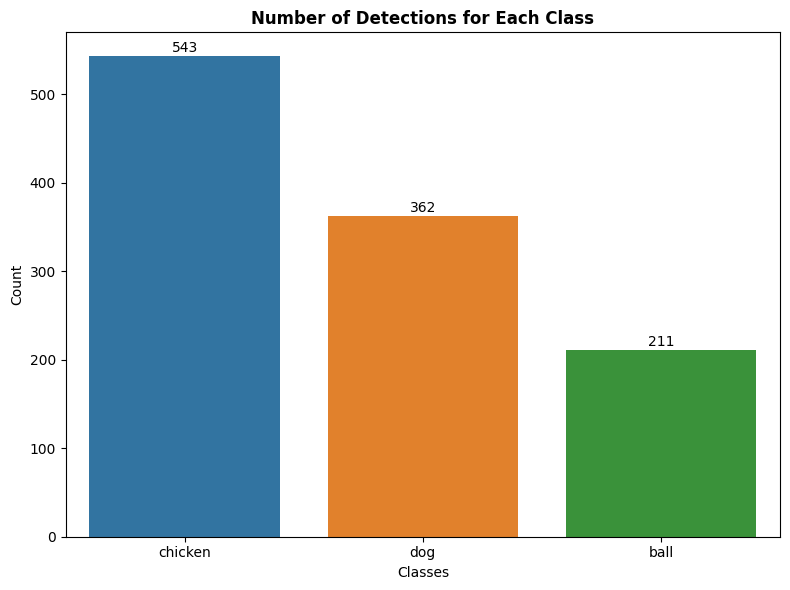

In [11]:
plt.figure(figsize=(8, 6))
sns.barplot(
    x = out_df['class_name'].value_counts().index,
    y = out_df['class_name'].value_counts().values
)

for index, value in enumerate(out_df['class_name'].value_counts().values):
    plt.text(index, value + 5, str(value), ha='center', fontsize=10)

plt.xlabel('Classes')
plt.ylabel('Count')
plt.title('Number of Detections for Each Class', fontweight='bold')
plt.tight_layout()
plt.show()

### Confidence Histogram:

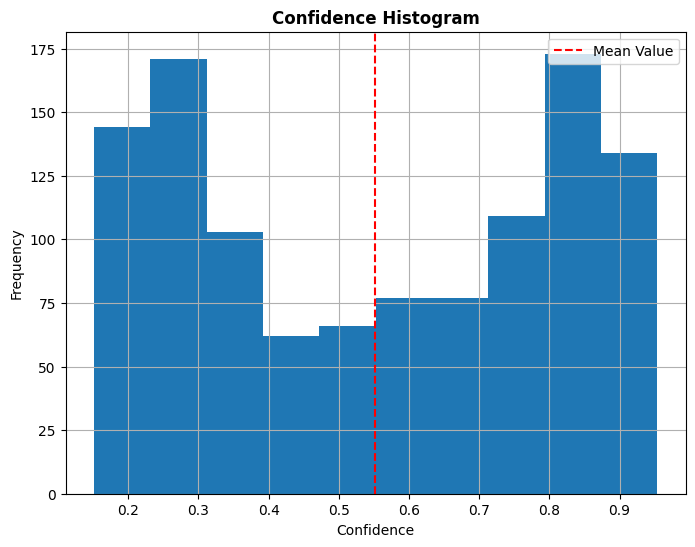

In [12]:
plt.figure(figsize=(8, 6))
out_df['confidence'].hist()

mean_value = out_df['confidence'].mean()
plt.axvline(mean_value, color='red', linestyle='--', label='Mean Value')

plt.xlabel('Confidence')
plt.ylabel('Frequency')
plt.legend()
plt.title('Confidence Histogram', fontweight='bold')
plt.show()

### Class-wise Confidence Histogram:

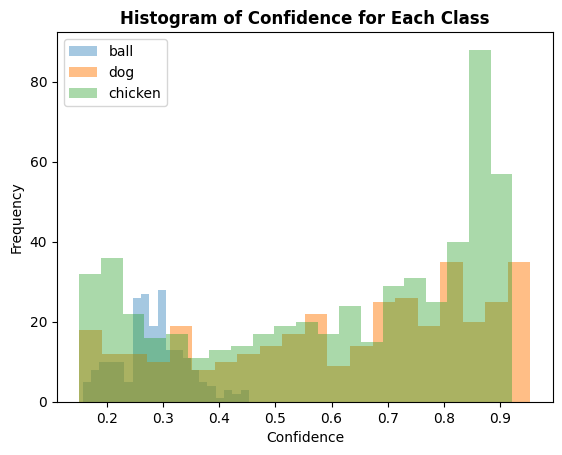

In [13]:
ball_data = out_df[out_df['class_name'] == 'ball']['confidence']
dog_data = out_df[out_df['class_name'] == 'dog']['confidence']
chicken_data = out_df[out_df['class_name'] == 'chicken']['confidence']

plt.hist(ball_data, bins=20, alpha=0.4, label='ball')
plt.hist(dog_data, bins=20, alpha=0.5, label='dog')
plt.hist(chicken_data, bins=20, alpha=0.4, label='chicken')

plt.xlabel('Confidence')
plt.ylabel('Frequency')
plt.title('Histogram of Confidence for Each Class', fontweight='bold')
plt.legend()
plt.show()